# 1. Exploration Data Analysis USA_HOUSE_PRICING Linear Regresion Machine Linearning Model
Este programa es para visualizar el conjunto de datos USA_HOUSE_PRICING y ejecutar un modelo de regresión lineal para predecir los precios de la vivienda. Antes de comenzar, la visualización de datos es importante

In [14]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
%matplotlib inline

In [27]:
dataset= pd.read_csv('USA_Housing.csv')

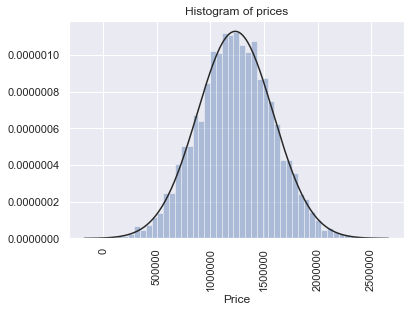

In [16]:
sns.distplot(dataset['Price'],fit=stats.norm, kde=False)
sns.set(color_codes=True)
plt.xticks(rotation=90)
plt.title("Histogram of prices")
matplotlib.pyplot.show()

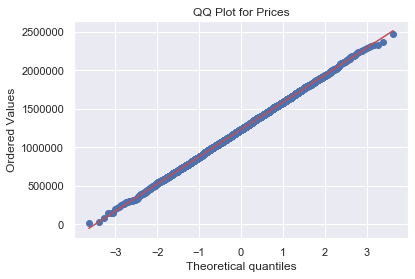

In [25]:
stats.probplot(x=dataset['Price'], dist = "norm", plot = plt)
plt.title("QQ Plot for Prices")
plt.show()

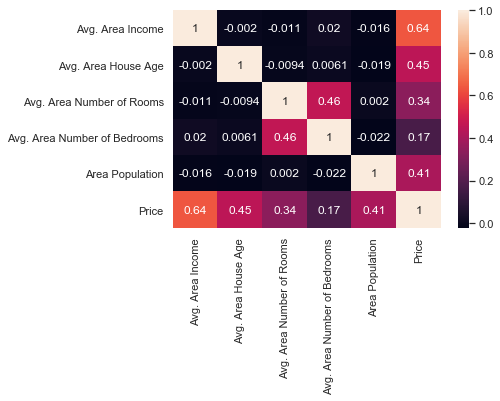

In [18]:
sns.heatmap(dataset.corr(),annot = True)

#this corr map is used to find the correlation between the attributes and the pricing so as to 
#get an idea about the relationship between them.

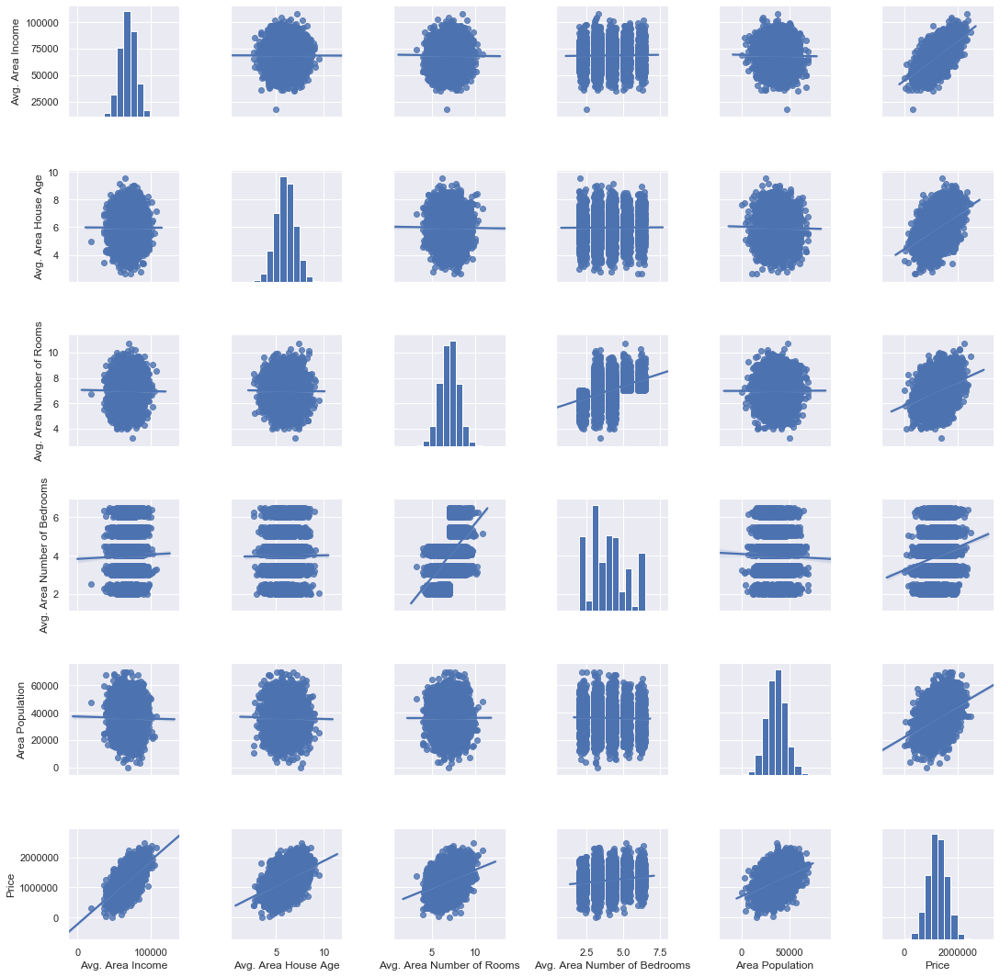

In [21]:
sns.pairplot(dataset, kind='reg')
matplotlib.pyplot.show()

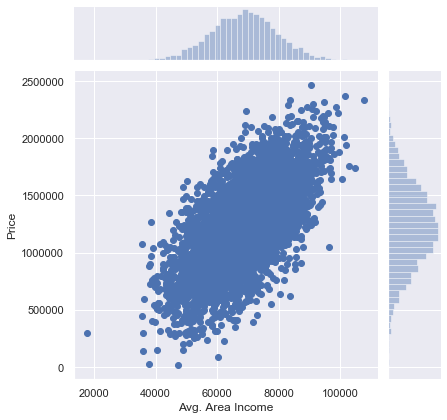

In [24]:
sns.jointplot(x="Avg. Area Income", y="Price", data=dataset)
matplotlib.pyplot.show()

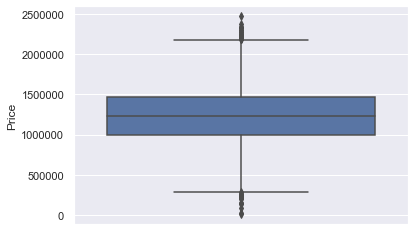

In [28]:
sns.boxplot(y='Price', data=dataset)

In [123]:
cols = ['Avg. Area Income','Avg. Area House Age','Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms','Area Population']

#plt.figure(figsize=(18,15))

for i,item in enumerate(cols):

    # Initialize the figure with a logarithmic x axis
    #plt.figure(figsize=(8,3))
    ax=sns.boxplot(x=item, y='Price', data=df ,orient= 'h')
    #ax.set_yscale("log")
    sns.set_context("paper", rc={"font.size":4,"axes.titlesize":5,"axes.labelsize":15,"xtick.labelsize": 15,"ytick.labelsize": 15 })
    plt.show()
          

SyntaxError: invalid syntax (<ipython-input-123-3db02ba18afb>, line 10)

In [49]:
#Separamos los otros atributos del atributo de predicción
x = df[['Avg. Area Income','Avg. Area House Age','Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms','Area Population']]

In [50]:
#Separamos el atributo de predicción en Y para el entrenamiento del modelo
y = df[['Price']]

In [51]:
#Separamos el atributo de predicción en Y para el entrenamiento del modelo
from sklearn.model_selection import train_test_split

In [52]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.4, random_state=101)

In [53]:
from sklearn.linear_model import LinearRegression

In [54]:
#Cargando el constructor del  modelo.
lm = LinearRegression()

In [109]:
#Entrenar o ajustar los datos de entrenamiento en el modelo
lm.fit(x_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [112]:
print(lm.intercept_[0])

-2640159.7968525263


In [113]:
coef=lm.coef_
print(coef)

[[2.15282755e+01 1.64883282e+05 1.22368678e+05 2.23380186e+03
  1.51504200e+01]]


In [116]:
cdf = pd.DataFrame(data=lm.coef_.reshape(5,1),index=x_train.columns,columns=['Coeff'])
cdf.reset_index(inplace =True)
cdf.append({'index':'intercept','Coeff':lm.intercept_[0]},ignore_index=True)

,index,Coeff
0,Avg. Area Income,2.152828e+01
1,Avg. Area House Age,1.648833e+05
2,Avg. Area Number of Rooms,1.223687e+05
3,Avg. Area Number of Bedrooms,2.233802e+03
4,Area Population,1.515042e+01
5,intercept,-2.640160e+06


In [117]:
predictions = lm.predict(x_test)

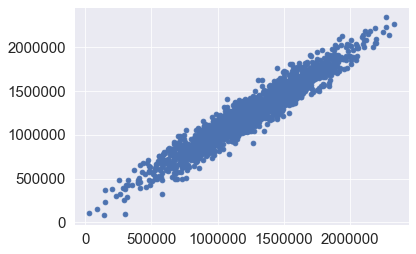

In [118]:
plt.scatter(y_test,predictions)
#to visualise the predictions and the test Y !! almost it is forming a linear line with less deviation

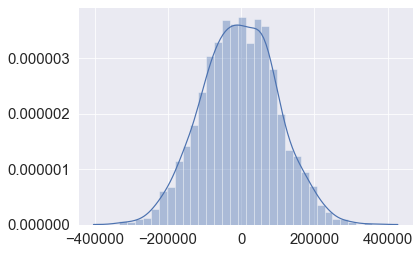

In [119]:
sns.distplot((y_test-predictions))

In [120]:
from sklearn import metrics

In [121]:
print('MAE:', metrics.mean_absolute_error(y_test, predictions))
print('MSE:', metrics.mean_squared_error(y_test, predictions))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, predictions)))

MAE: 82288.22251914948
MSE: 10460958907.209064
RMSE: 102278.8292229094
